In [1]:
#importing libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
import random
import math

In [2]:
#Loading cleaned data 
df=pd.read_csv('data/globalterrorism_cleaned.csv')
print("Data imported successfully")

Data imported successfully


In [3]:
df.head()

,year,extended,country,region,state,city,lat,lon,multiple,success,...,nter,claimed,weapontype,nkilled,nkilledter,nwounded,nwoundedter,property,propertyextent,countrycode
0,1970,0,Dominican Republic,Central America & Caribbean,Unknown,Santo Domingo,18.456792,-69.951164,0,1,...,0,0,Unknown,1,0,0,0,0,Unknown,DOM
1,1970,0,Mexico,North America,Federal,Mexico city,19.371887,-99.086624,0,1,...,7,0,Unknown,0,0,0,0,0,Unknown,MEX
2,1970,0,Philippines,Southeast Asia,Tarlac,Unknown,15.478598,120.599741,0,1,...,0,0,Unknown,1,0,0,0,0,Unknown,PHL
3,1970,0,Greece,Western Europe,Attica,Athens,37.997490,23.762728,0,1,...,0,0,Explosives,0,0,0,0,1,Unknown,GRC
4,1970,0,Japan,East Asia,Fukouka,Fukouka,33.580412,130.396361,0,1,...,0,0,Incendiary,0,0,0,0,1,Unknown,JPN


In [4]:
# Read Our Edgelist
us_graph = nx.from_pandas_edgelist(df,source="gname",target="region")

In [5]:
type(us_graph)

networkx.classes.graph.Graph

In [6]:
# Info
nx.info(us_graph)

'Name: \nType: Graph\nNumber of nodes: 3475\nNumber of edges: 4022\nAverage degree:   2.3148'

In [7]:
# Check All Nodes/Object/People
us_graph.nodes()

NodeView(('MANO-D', 'Central America & Caribbean', '23rd of September Communist League', 'North America', 'Unknown', 'Southeast Asia', 'Western Europe', 'East Asia', 'Black Nationalists', 'Tupamaros (Uruguay)', 'South America', "New Year's Gang", 'Weather Underground, Weathermen', 'Left-Wing Militants', 'Armed Commandos of Liberation', 'Commune 1', 'Eastern Europe', 'Strikers', 'Student Radicals', 'White extremists', 'Armed Forces of National Liberation- Venezuela (FALN)', "New People's Army (NPA)", 'Armed Revolutionary Independence Movement (MIRA)', 'Popular Front for the Liberation of Palestine (PFLP)', 'Popular Front for the Liberation of Palestine, Gen Cmd (PFLP-GC)', 'Middle East & North Africa', 'Eritrean Liberation Front', 'Rebel Armed Forces of Guatemala (FAR)', 'Ku Klux Klan', 'Popular Revolutionary Vanguard (VPR)', 'Revolutionary Force 9', 'Puerto Rican Nationalists', 'Chicano Liberation Front', 'Puerto Rican Resistance Movement', 'Black Panthers', 'Dominican Popular Movement

In [8]:
len(us_graph.nodes())

3475

In [10]:
len(us_graph.edges())

4022

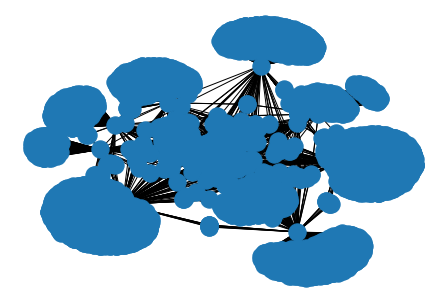

In [11]:
nx.draw(us_graph)

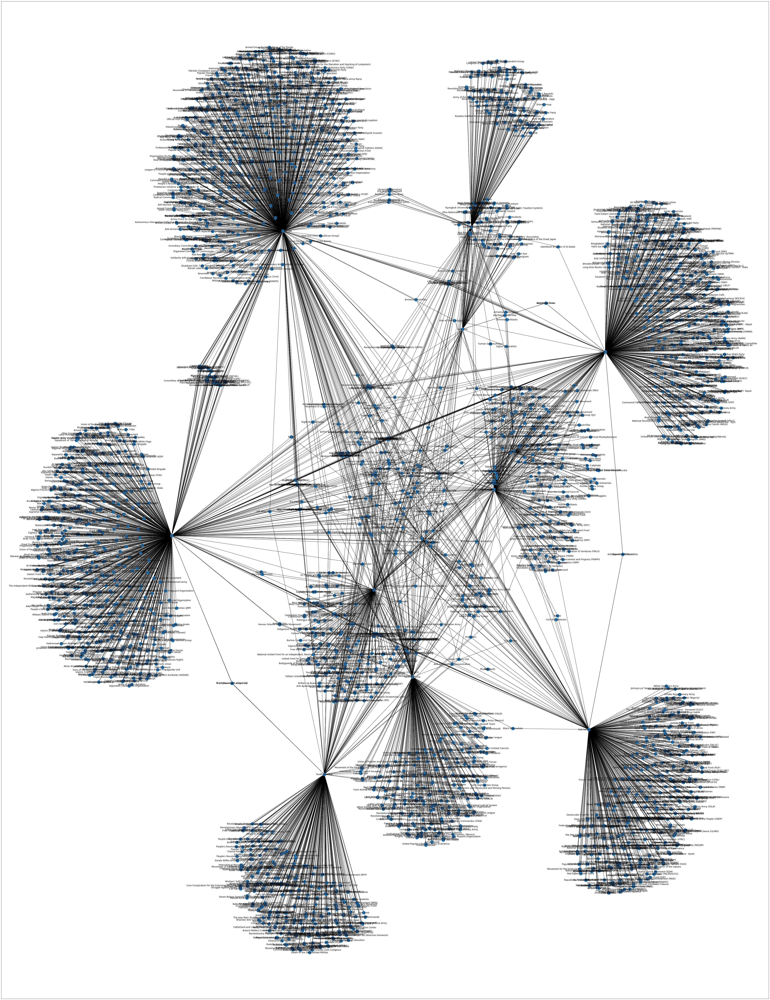

In [46]:
plt.figure(figsize=(75,100))
nx.draw_networkx(us_graph)
plt.show()

### Degree of centrality

In [13]:
# General Connection
nx.degree(us_graph)

DegreeView({'MANO-D': 1, 'Central America & Caribbean': 212, '23rd of September Communist League': 1, 'North America': 297, 'Unknown': 12, 'Southeast Asia': 203, 'Western Europe': 860, 'East Asia': 82, 'Black Nationalists': 2, 'Tupamaros (Uruguay)': 1, 'South America': 353, "New Year's Gang": 1, 'Weather Underground, Weathermen': 1, 'Left-Wing Militants': 3, 'Armed Commandos of Liberation': 1, 'Commune 1': 1, 'Eastern Europe': 157, 'Strikers': 5, 'Student Radicals': 2, 'White extremists': 3, 'Armed Forces of National Liberation- Venezuela (FALN)': 1, "New People's Army (NPA)": 2, 'Armed Revolutionary Independence Movement (MIRA)': 1, 'Popular Front for the Liberation of Palestine (PFLP)': 4, 'Popular Front for the Liberation of Palestine, Gen Cmd (PFLP-GC)': 2, 'Middle East & North Africa': 718, 'Eritrean Liberation Front': 2, 'Rebel Armed Forces of Guatemala (FAR)': 1, 'Ku Klux Klan': 1, 'Popular Revolutionary Vanguard (VPR)': 1, 'Revolutionary Force 9': 1, 'Puerto Rican Nationalists'

In [37]:
# Degree of Connection 
nx.degree(us_graph,"Strikers")

5

### Betweener Centrality

In [38]:
nx.betweenness_centrality(us_graph)

{'MANO-D': 0.0,
 'Central America & Caribbean': 0.0938504117009908,
 '23rd of September Communist League': 0.0,
 'North America': 0.13162706489995682,
 'Unknown': 0.035255368872556835,
 'Southeast Asia': 0.08643477781920948,
 'Western Europe': 0.38926945167459426,
 'East Asia': 0.03428670919999381,
 'Black Nationalists': 0.0009150118293978077,
 'Tupamaros (Uruguay)': 0.0,
 'South America': 0.1627207663449449,
 "New Year's Gang": 0.0,
 'Weather Underground, Weathermen': 0.0,
 'Left-Wing Militants': 0.0022804656545914667,
 'Armed Commandos of Liberation': 0.0,
 'Commune 1': 0.0,
 'Eastern Europe': 0.06717426069420722,
 'Strikers': 0.008094923527822104,
 'Student Radicals': 0.00027871855075190227,
 'White extremists': 0.0031406306004962852,
 'Armed Forces of National Liberation- Venezuela (FALN)': 0.0,
 "New People's Army (NPA)": 0.0003250761136652702,
 'Armed Revolutionary Independence Movement (MIRA)': 0.0,
 'Popular Front for the Liberation of Palestine (PFLP)': 0.005940108516822964,
 

In [39]:
best_connector = nx.betweenness_centrality(us_graph)
for w in sorted(best_connector, key=best_connector.get, reverse=True):
    print(w, best_connector[w])

Western Europe 0.38926945167459426
Middle East & North Africa 0.3274656180184176
South Asia 0.27334396111455783
Sub-Saharan Africa 0.22314252226600645
South America 0.1627207663449449
North America 0.13162706489995682
Central America & Caribbean 0.0938504117009908
Southeast Asia 0.08643477781920948
Eastern Europe 0.06717426069420722
Unknown 0.035255368872556835
East Asia 0.03428670919999381
Separatists 0.02939004028863858
Guerrillas 0.022374490403008207
Students 0.02211713010759515
Gunmen 0.021621549181340575
Anti-Government Group 0.020409956687166914
Muslim extremists 0.019510418916355222
Rebels 0.01767670401745511
Central Asia 0.017408813117497094
Right-wing extremists 0.016664697719247997
Islamist extremists 0.016613676135043238
Right-Wing Group 0.015494999396472304
Extremists 0.015457288409502131
Left-wing extremists 0.015021783095957645
Black September 0.012564038531842476
Left-Wing Terrorists 0.012545211024226899
Terrorists 0.01242654973375455
Sunni Muslim extremists 0.0120297110

Proletarian Armed Squads 0.0
Armed Proletarian Patrols 0.0
Radical Communist Armed Nucleus 0.0
Armed Commandos in the Fighting Army of Mario Zichieri 0.0
Guerrillas of Christ the King 0.0
Confederation of Iranian Students/National Union (CISNU) 0.0
Armed Fight for Communism 0.0
Khristos Kasimis 0.0
Communist Fighting Corunim- Maria Anna Maria 0.0
Worker Autonomy, Continuous Struggle 0.0
Popular Revolutionary Movement (Colombia) 0.0
Fighting Popular Rally 0.0
PORE 0.0
Christ Chaos 0.0
Committee of action against bull fights 0.0
28th of December Group 0.0
Armed Revolutionary Groups 0.0
International Communist Brigade 0.0
Armed Revolutionary Nuclei (NAR) 0.0
Armed Nuclei for Territorial Counterpower 0.0
Southern Nucleus of Communist Counterpower 0.0
Iberian Anarchist Federation 0.0
Anti Shah of Iran 0.0
Breton Terrorist 0.0
Anti-Imperialist Fighters for a Free Palestine 0.0
Catalan independence group 0.0
Begumcans Cell 0.0
Argentine Youths for Sovereignty 0.0
Revolutionary Workers' Counci

Islamic Liberation Organization 0.0
Anti-American Arab Liberation Front 0.0
Tribal Separatists 0.0
Kisan Indian Organization 0.0
Patria y Libertad (Fatherland and Liberty) 0.0
Armed Communist Front 0.0
Arab Commando Cells 0.0
Commando Internacionalista Simon Bolivar 0.0
Arab Revolutionary Front 0.0
Bangladesh Sarbahara Party 0.0
A Resistance Group 0.0
Montoneros Patria Libre 0.0
Sudan People's Liberation Army (SPLA) 0.0
Salah al-Din Squad 0.0
Al-Marabitun Revolutionary Committee 0.0
Eelam People's Revolutionary Liberation Front (EPRLF) 0.0
Commandos of France 0.0
Feliciano Argueta Front 0.0
Japan Socialist Youth League of the Revolutionary Workers' Association 0.0
Black War 0.0
Palestinian Revolution Forces 0.0
Major Muhammad Zuhnyn Group 0.0
United Nicaraguan Opposition 0.0
Brunswijk Jungle Commando 0.0
United Nasirite Organizaiton 0.0
Revolutionary Liberation Cells 0.0
Schiedam Youth Front 0.0
The Illegal Fisherman of the Night 0.0
SYS 0.0
S. O. S. France 0.0
Into the Blue Commando o

Ittehad-i-Islami 0.0
Coca Farmers 0.0
Revolutionary Front for Hatian Advancement and Progress (FRAPH) 0.0
Minority Unity Forum 0.0
Movement for Dignity and Soverignty 0.0
Suriname Liberation Front 0.0
Motherland Party 0.0
Human Rights Defence Committee 0.0
Former Muslim Guerrillas 0.0
Taihikai (Great Sadness) 0.0
Ningo Tribe 0.0
Southern Sierra Peasant Organization 0.0
The Islamic Movement 0.0
Habr Gedir Clan 0.0
Naga Students Federation 0.0
Popular Liberation Front Urban Commando 0.0
Association of Students and Pupils in Mali (AEEM) 0.0
Zulu Miners 0.0
Anti-Fascist Action 0.0
Furious Rebellion 0.0
Popular Front for the Liberation of the Sahara 0.0
Puka Inti Maoist Communist Party 0.0
Ultra Nationalist Group, name not given 0.0
Francisco Villa People's Front 0.0
Harkat ul Ansar 0.0
Former Interior Ministry Officers 0.0
Kurdish Democratic Party-Iraq (KDP) 0.0
Sandval (union) Movement 0.0
Sammilito Sangskritik Jote (Alliance of Cultural Forums) 0.0
Afghan War Veterans 0.0
People's Nation

The Islamic Revolution to Liberate Palestine 0.0
Cambodian Freedom Fighters (CFF) 0.0
Allied Democratic Forces of Guinea (RDFG) 0.0
Islamic Defenders' Front (FPI) 0.0
Anarchists Attack Team 0.0
Popular Resistance Committees 0.0
Intifada Martyrs 0.0
United People's Democratic Solidarity (UPDS) 0.0
Civic United Front (CUF) 0.0
National Liberation Army (NLA) (Macedonia) 0.0
Supporters of Saddam Hussein 0.0
Chukakuha Revolutionary Army 0.0
Marhan Clan 0.0
Civil Association for Peace in Colombia, Asocipaz 0.0
Liberation Army for Presevo, Medvedja and Bujanovac (UCPMB) 0.0
Forces for the Defense of Democracy (FDD) 0.0
Chakma tribal group 0.0
Tanzim 0.0
Liberation War Veterans Association 0.0
Haika 0.0
Kanglei Yawol Kanna Lup (KYKL) 0.0
Dayak gang 0.0
Rodolfo Walsh National Command 0.0
Supporters of Muhammad Umar Habib 0.0
Supporters of Muse Sudi Yalahow 0.0
Special Purpose Islamic Regiment (SPIR) 0.0
Croat Democratic Union 0.0
Students Islamic Movement of India (SIMI) 0.0
Anti-Imperialist Te

Achik National Cooperative Army (ANCA) 0.0
Misrata Brigades 0.0
Al-Madani Brigade 0.0
Rabha National Security Force 0.0
Greater Damascus Operations Room 0.0
Mabanese Defence Forces 0.0
Knights of Janzour 0.0
Orfei Harsha'am 0.0
Abu Obaida bin Jarrah Brigade 0.0
Jaish-e-Khorasan (JeK) 0.0
Unified Communist Party of Nepal (Maoist) 0.0
German Resistance Movement 0.0
Halqa-e-Mehsud 0.0
Jamaat-ul-Ahrar 0.0
Random Anarchists 0.0
Proletarian Solidarity 0.0
Al-Jihad (Pakistan) 0.0
Shura Council of Benghazi Revolutionaries 0.0
Jund al-Khilafa 0.0
Nduma Defense of Congo (NDC) 0.0
Jharkhand Prastuti Committee (JPC) 0.0
Manipur Nationalist Revolutionary Party (MNRP) 0.0
The Irish Volunteers 0.0
Economic Freedom Fighters 0.0
Cossack Separatists 0.0
Army of the Tribes 0.0
Al-Zintan Revolutionaries' Military Council 0.0
Yazidi extremists 0.0
Donskoy Army 0.0
Al-Sawaiq Brigade 0.0
Mawlawi and Mansour Group 0.0
Zawiya Martyrs Brigade 0.0
Barqa Province of the Islamic State 0.0
Anarchist Anti-Capitalist

### Association

In [40]:
nx.clustering(us_graph)

{'MANO-D': 0,
 'Central America & Caribbean': 0,
 '23rd of September Communist League': 0,
 'North America': 0,
 'Unknown': 0,
 'Southeast Asia': 0,
 'Western Europe': 0,
 'East Asia': 0,
 'Black Nationalists': 0,
 'Tupamaros (Uruguay)': 0,
 'South America': 0,
 "New Year's Gang": 0,
 'Weather Underground, Weathermen': 0,
 'Left-Wing Militants': 0,
 'Armed Commandos of Liberation': 0,
 'Commune 1': 0,
 'Eastern Europe': 0,
 'Strikers': 0,
 'Student Radicals': 0,
 'White extremists': 0,
 'Armed Forces of National Liberation- Venezuela (FALN)': 0,
 "New People's Army (NPA)": 0,
 'Armed Revolutionary Independence Movement (MIRA)': 0,
 'Popular Front for the Liberation of Palestine (PFLP)': 0,
 'Popular Front for the Liberation of Palestine, Gen Cmd (PFLP-GC)': 0,
 'Middle East & North Africa': 0,
 'Eritrean Liberation Front': 0,
 'Rebel Armed Forces of Guatemala (FAR)': 0,
 'Ku Klux Klan': 0,
 'Popular Revolutionary Vanguard (VPR)': 0,
 'Revolutionary Force 9': 0,
 'Puerto Rican Nationali

### Most Influential

In [17]:
nx.degree_centrality(us_graph)

{'MANO-D': 0.0002878526194588371,
 'Central America & Caribbean': 0.06102475532527347,
 '23rd of September Communist League': 0.0002878526194588371,
 'North America': 0.08549222797927462,
 'Unknown': 0.003454231433506045,
 'Southeast Asia': 0.05843408175014393,
 'Western Europe': 0.2475532527345999,
 'East Asia': 0.023603914795624643,
 'Black Nationalists': 0.0005757052389176742,
 'Tupamaros (Uruguay)': 0.0002878526194588371,
 'South America': 0.1016119746689695,
 "New Year's Gang": 0.0002878526194588371,
 'Weather Underground, Weathermen': 0.0002878526194588371,
 'Left-Wing Militants': 0.0008635578583765113,
 'Armed Commandos of Liberation': 0.0002878526194588371,
 'Commune 1': 0.0002878526194588371,
 'Eastern Europe': 0.04519286125503742,
 'Strikers': 0.0014392630972941854,
 'Student Radicals': 0.0005757052389176742,
 'White extremists': 0.0008635578583765113,
 'Armed Forces of National Liberation- Venezuela (FALN)': 0.0002878526194588371,
 "New People's Army (NPA)": 0.00057570523891

In [18]:
sorted(nx.degree_centrality(us_graph).values())

[0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194588371,
 0.0002878526194

In [19]:
most_influential = nx.degree_centrality(us_graph)

In [20]:
for w in sorted(most_influential, key=most_influential.get, reverse=True):
    print(w, most_influential[w])

Western Europe 0.2475532527345999
Middle East & North Africa 0.20667818077144504
South Asia 0.16753022452504318
Sub-Saharan Africa 0.13413932066781808
South America 0.1016119746689695
North America 0.08549222797927462
Central America & Caribbean 0.06102475532527347
Southeast Asia 0.05843408175014393
Eastern Europe 0.04519286125503742
East Asia 0.023603914795624643
Central Asia 0.014104778353483017
Australasia & Oceania 0.012377662636729994
Unknown 0.003454231433506045
Separatists 0.003166378814047208
Muslim extremists 0.0025906735751295338
Gunmen 0.0025906735751295338
Students 0.002302820955670697
Guerrillas 0.002302820955670697
Right-wing extremists 0.00201496833621186
Left-wing extremists 0.00201496833621186
Anti-Government Group 0.00201496833621186
Right-Wing Group 0.00201496833621186
Extremists 0.00201496833621186
Rebels 0.00201496833621186
Islamist extremists 0.00201496833621186
Jihadi-inspired extremists 0.00201496833621186
Islamic State of Iraq and the Levant (ISIL) 0.0020149683

Meitei extremists 0.0002878526194588371
Greek Popular Resistance 0.0002878526194588371
League of French Fighters Against Jewish Occupation 0.0002878526194588371
Coordination for Revolutionary Action (CAR) 0.0002878526194588371
Proletarian Fighting Patrol 0.0002878526194588371
Lesotho Liberation Army (LLA) 0.0002878526194588371
Communist Nuclei of Counter Power 0.0002878526194588371
Popular Revolutionary Movement (Italy) 0.0002878526194588371
Territorial Communist Command 0.0002878526194588371
Hawaiian extremists 0.0002878526194588371
Territorial Cells for Boycotting the Elections 0.0002878526194588371
Ecology and Antinuclear Revolutionary Party (CRAE) 0.0002878526194588371
International Committee Against Nazism 0.0002878526194588371
Colombians 0.0002878526194588371
Pan Africanist Congress (PAC) 0.0002878526194588371
The Jewish Execution with Silence 0.0002878526194588371
Mizo National Front 0.0002878526194588371
Territorial Resistance Army 0.0002878526194588371
Radicals 0.0002878526194

Al-Marabitun Revolutionary Committee 0.0002878526194588371
Eelam People's Revolutionary Liberation Front (EPRLF) 0.0002878526194588371
Commandos of France 0.0002878526194588371
Feliciano Argueta Front 0.0002878526194588371
Japan Socialist Youth League of the Revolutionary Workers' Association 0.0002878526194588371
Black War 0.0002878526194588371
Palestinian Revolution Forces 0.0002878526194588371
Major Muhammad Zuhnyn Group 0.0002878526194588371
United Nicaraguan Opposition 0.0002878526194588371
Brunswijk Jungle Commando 0.0002878526194588371
United Nasirite Organizaiton 0.0002878526194588371
Revolutionary Liberation Cells 0.0002878526194588371
Schiedam Youth Front 0.0002878526194588371
The Illegal Fisherman of the Night 0.0002878526194588371
SYS 0.0002878526194588371
S. O. S. France 0.0002878526194588371
Into the Blue Commando of the Revolutionary Cells 0.0002878526194588371
Commander Gonzalo Southern Group 0.0002878526194588371
Armed Commandos for Liberation 0.0002878526194588371
Sin

New Indigenous Army 0.0002878526194588371
Palestinian Activists 0.0002878526194588371
United Students Forum 0.0002878526194588371
Shop owners 0.0002878526194588371
Ganda Koi 0.0002878526194588371
Movement of the Islamic State (MEI) 0.0002878526194588371
Korea Univ. Students 0.0002878526194588371
Council for Popular Justice 0.0002878526194588371
Albatros Commando 0.0002878526194588371
Turks of Western Thrace 0.0002878526194588371
Lord's Resistance Army (LRA) 0.0002878526194588371
Colombia Without Guerrillas 0.0002878526194588371
Bosnian Serbs 0.0002878526194588371
Iraqi Islamic Vanguards for National Salvation (IIVNS) 0.0002878526194588371
Socialist Chhatra League 0.0002878526194588371
U/I Asian Gang 0.0002878526194588371
Iraqi National Congress (INC) 0.0002878526194588371
U/I Somali Militiamen 0.0002878526194588371
Presidential Movement (MP) Militiamen 0.0002878526194588371
U/I Private army of wral politician 0.0002878526194588371
Bosnian Croats 0.0002878526194588371
Pro-Khasbulaton Re

Samyukta Janatantrik Terai Mukti Morcha (SJTMM) 0.0002878526194588371
National Socialist Council of Nagaland-Khaplang (NSCN-K) 0.0002878526194588371
Jihadi Movement of the Sunna People of Iran 0.0002878526194588371
Shan State Army - South (SSA-S) 0.0002878526194588371
Caucasus Emirate 0.0002878526194588371
Forbidden Blockade (Greece) 0.0002878526194588371
National Liberation Front (FNL) (Burundi) 0.0002878526194588371
Anti-Democratic Struggle 0.0002878526194588371
LW 0.0002878526194588371
Terai Cobra 0.0002878526194588371
Jharkhand Liberation Tigers (JLT) 0.0002878526194588371
Hmar People's Convention-Democracy (HPC-D) 0.0002878526194588371
Al-Mujahedin Brigades (Palestine) 0.0002878526194588371
Madhesi Mukti Tigers (MMT) 0.0002878526194588371
Runda Kumpulan Kecil (RKK) 0.0002878526194588371
Eastern Turkistan Islamic Movement (ETIM) 0.0002878526194588371
Janatantrik Terai Mukti Morcha- Rajan Mukti (JTMM-R) 0.0002878526194588371
Future movement (Lebanon) 0.0002878526194588371
Progressiv

National Socialist Council of Nagaland-Reformation (NSCN-R) 0.0002878526194588371
Niger Delta Forest Army (NDFA) 0.0002878526194588371
Irrintzi 0.0002878526194588371
Birsa Commando Force (BCF) 0.0002878526194588371
Mai Mai Charles Militia 0.0002878526194588371
Union of Peoples and Organizations of the State of Guerrero (UPOEG) 0.0002878526194588371
Gorkha Janmukti Morcha (GJM) 0.0002878526194588371
Anti-Republican extremists 0.0002878526194588371
Shutdown G20: Take Hamburg offline! 0.0002878526194588371
National Movement of Revolutionaries (MNR) 0.0002878526194588371
Ansar al-Sharia (Pakistan) 0.0002878526194588371
Liberal Democratic Council for Missing Land 0.0002878526194588371
Equilibrio Nacional 0.0002878526194588371
Hizballah-Iraq 0.0002878526194588371
United Party for National Development (UPND) 0.0002878526194588371
Justicieros de la Frontera 0.0002878526194588371
Arab-Israeli extremists 0.0002878526194588371
Nawasi Brigade 0.0002878526194588371
Informal Feminist Commando for An

### Most Important Connection

In [26]:
nx.eigenvector_centrality(us_graph, max_iter=1000)

{'MANO-D': 0.0011776138517800862,
 'Central America & Caribbean': 0.03607735547178182,
 '23rd of September Communist League': 0.0024851592068107086,
 'North America': 0.07613528999571235,
 'Unknown': 0.04757378743045895,
 'Southeast Asia': 0.04889318819679832,
 'Western Europe': 0.5974608545289671,
 'East Asia': 0.015905582471536266,
 'Black Nationalists': 0.005267934931253775,
 'Tupamaros (Uruguay)': 0.002294875154649751,
 'South America': 0.07030575140790657,
 "New Year's Gang": 0.0024851592068107086,
 'Weather Underground, Weathermen': 0.0024851592068107086,
 'Left-Wing Militants': 0.03228349680837769,
 'Armed Commandos of Liberation': 0.0024851592068107086,
 'Commune 1': 0.001300807827003609,
 'Eastern Europe': 0.039851523743910135,
 'Strikers': 0.030003310620885956,
 'Student Radicals': 0.0030043390079414495,
 'White extremists': 0.02476986817951248,
 'Armed Forces of National Liberation- Venezuela (FALN)': 0.002294875154649751,
 "New People's Army (NPA)": 0.006139669186739096,
 '

In [29]:
most_important_link = nx.eigenvector_centrality(us_graph, max_iter=1000)

In [30]:
for w in sorted(most_important_link, key=most_important_link.get, reverse=True):
    print(w, most_important_link[w])

Western Europe 0.5974608545289671
Middle East & North Africa 0.3154404471123052
South Asia 0.13920159974491744
Sub-Saharan Africa 0.0852530639451333
North America 0.07613528999571235
South America 0.07030575140790657
Southeast Asia 0.04889318819679832
Unknown 0.04757378743045895
Separatists 0.04508862822364825
Students 0.044019996675340345
Muslim extremists 0.043582118622898375
Guerrillas 0.043494079346182594
Anti-Government Group 0.0430824906986373
Islamist extremists 0.04250674954656347
Rebels 0.04231646549440251
Left-wing extremists 0.04123722095089728
Extremists 0.040711303621739525
Eastern Europe 0.039851523743910135
Al-Qaida 0.039610001692207464
Sunni Muslim extremists 0.03941971764004651
Terrorists 0.03941049579473592
Palestinians 0.039122101122414155
Black September 0.038957087714822904
Left-Wing Terrorists 0.038333735568514264
Right-Wing Group 0.03816872216092302
Hezbollah 0.03777273633501581
Shia Muslim extremists 0.037124842485396756
Muslim Fundamentalists 0.0371248424853967

New Revolutionary Popular Struggle (NELA) 0.019501933248258708
Rabid Brothers of Giuliani 0.019501933248258708
Democratic Iraqi Opposition of Germany 0.019501933248258708
CCCCC 0.019501933248258708
Resistenza Corsa 0.019501933248258708
Supporters of Johnny Adair 0.019501933248258708
Enraged Revolutionaries 0.019501933248258708
The War That Was Never Declared 0.019501933248258708
Dissident Republicans 0.019501933248258708
Proletarian Nuclei for Communism 0.019501933248258708
Popular Revolutionary Action 0.019501933248258708
Loyalist Action Force 0.019501933248258708
Moroccan extremists 0.019501933248258708
Resistance Cell 0.019501933248258708
Anonymous Underground Movement (MCA) 0.019501933248258708
French Armed Islamic Front 0.019501933248258708
Hofstad Network 0.019501933248258708
Global Intifada 0.019501933248258708
Al-Qaida Organization for Jihad in Sweden 0.019501933248258708
Anti-State Justice 0.019501933248258708
Revolutionary Action of Liberation 0.019501933248258708
Solidarity 

Al-Mus'abi Tribe 0.010296404353308282
Military Council of the Tribal Revolutionaries (MCTR) 0.010296404353308282
Jaish Tahkim al-Din 0.010296404353308282
Haftar Militia 0.010296404353308282
Jaish al-Islam (Libya) 0.010296404353308282
Rafallah al-Sahati Brigade 0.010296404353308282
Southern Front 0.010296404353308282
Mitiga Militia 0.010296404353308282
Saraya al-Mukhtar 0.010296404353308282
Libyan Militia 0.010296404353308282
Sinai Province of the Islamic State 0.010296404353308282
Barq al-Nasser Brigade 0.010296404353308282
Islamic Youth Shura Council 0.010296404353308282
February 17 Martyrs Brigade 0.010296404353308282
Misrata Brigades 0.010296404353308282
Al-Madani Brigade 0.010296404353308282
Greater Damascus Operations Room 0.010296404353308282
Knights of Janzour 0.010296404353308282
Orfei Harsha'am 0.010296404353308282
Abu Obaida bin Jarrah Brigade 0.010296404353308282
Shura Council of Benghazi Revolutionaries 0.010296404353308282
Jund al-Khilafa 0.010296404353308282
Army of the T

Front for the Liberation of Cabinda / Cabinda Armed Forces (FLEC-FAC) 0.0027827757244430662
Somali Gang 0.0027827757244430662
War Veterans 0.0027827757244430662
Somali National Alliance 0.0027827757244430662
Dioulas tribal group 0.0027827757244430662
Farighan 0.0027827757244430662
Young Pioneers 0.0027827757244430662
Kenya African National Union (KANU) 0.0027827757244430662
Gunmen loyal to Mohammad Farah Aideed 0.0027827757244430662
Boer Republikeinse Leer 0.0027827757244430662
New Patriotic Party (NPP) 0.0027827757244430662
Al-Ittihaad al-Islami (AIAI) 0.0027827757244430662
Xhosa Tribal Workers 0.0027827757244430662
Kotoko Tribal Group 0.0027827757244430662
Togolese Dissidents 0.0027827757244430662
Revolutionary United Front (RUF) 0.0027827757244430662
Mousa Ismail sub-clan 0.0027827757244430662
Rival Zulu Group, name not stated 0.0027827757244430662
Uganda Democratic Christian Army (UDCA) 0.0027827757244430662
Ningo Tribe 0.0027827757244430662
Habr Gedir Clan 0.0027827757244430662
As

People's Guerrilla Front 0.002294875154649751
People's Revolutionary Organization 0.002294875154649751
People's Fatherland Movement 0.002294875154649751
Anti-govt student groups 0.002294875154649751
Central University students 0.002294875154649751
Artigas Guard Commando 0.002294875154649751
Red Dawn Front (Frente Amanecer Rojo) 0.002294875154649751
Juan Antonio Lavalleja Command 0.002294875154649751
Kolla Benjo Cruz Command 0.002294875154649751
Manuel Ascencio Padilla Group 0.002294875154649751
Chilean Committee of Support for the Peruvian Revolution 0.002294875154649751
Heroes of Canto Grande 0.002294875154649751
Comando Independiente Revolucionario 0.002294875154649751
Revolutionary Bolivariano Movement 200 0.002294875154649751
Fuerzas Populares Jose Leonardo Chirinos 0.002294875154649751
Grupo Libertad 0.002294875154649751
Guajajara Tribe 0.002294875154649751
Bolivarian Army of Liberation 0.002294875154649751
February 27 Revolutionary Armed Forces 0.002294875154649751
Socialist Reco